In [1]:
import pandas as pd

df = pd.read_csv("../data/processed_trees.csv")

In [2]:
df.shape

(26811, 23)

In [3]:
df = df.dropna(subset=['Geom'])

In [4]:
import json

def as_tuple(s):
    return json.loads(s)['coordinates']

def get_coord(x, pos):
    return as_tuple(x)[pos]

df['lon'] = df.Geom.apply(get_coord, args=[0])
df['lat'] = df.Geom.apply(get_coord, args=[1])

In [5]:
df['NEIGHBOURHOOD_NAME'] = df['NEIGHBOURHOOD_NAME'].str.title()
#df['NEIGHBOURHOOD_NAME'] = df['NEIGHBOURHOOD_NAME'].str.replace('Dunbar-Southlands', 'Dunbar Southlands')
#df['NEIGHBOURHOOD_NAME'] = df['NEIGHBOURHOOD_NAME'].str.replace('Arbutus-Ridge', 'Arbutus Ridge')

In [6]:
import plotly.express as px

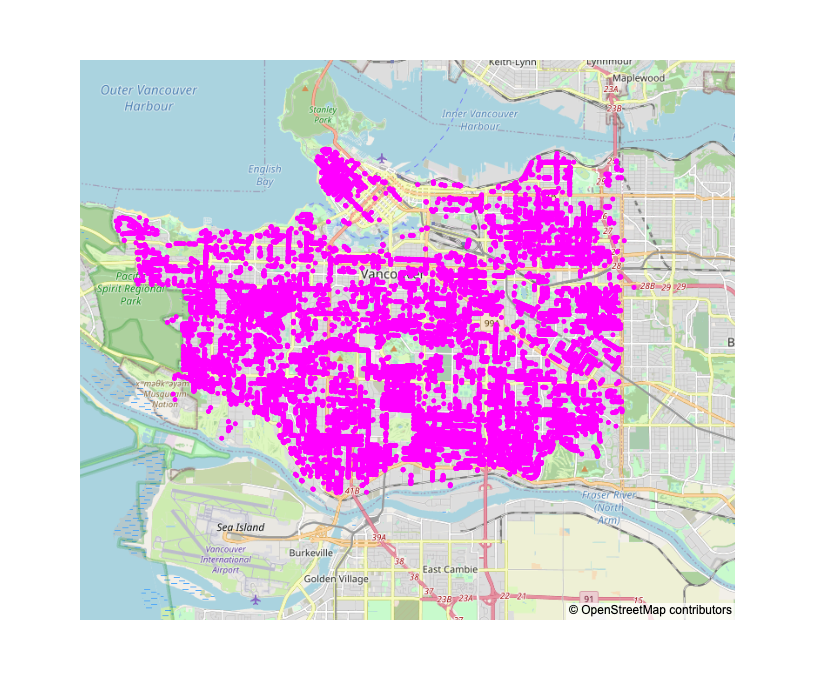

In [7]:
fig = px.scatter_mapbox(df, lat="lat", lon="lon",
                        color_discrete_sequence=["fuchsia"], zoom=10.8, height=700)
fig.update_layout(mapbox_style="open-street-map")

In [8]:
import altair as alt
#url_geojson = 'https://raw.githubusercontent.com/codeforgermany/click_that_hood/main/public/data/vancouver.geojson'
url_geojson = "https://raw.githubusercontent.com/UBC-MDS/cherry_blossom_tracker/main/data/vancouver.geojson"
data_geojson_remote = alt.Data(url=url_geojson, format=alt.DataFormat(property='features',type='json'))

alt.Chart(data_geojson_remote).mark_geoshape(
).encode(
    color="properties.name:N"
).project(
    type='identity', reflectY=True
)

alt.Chart(...)

In [9]:
df.NEIGHBOURHOOD_NAME.unique()

array(['Dunbar-Southlands', 'Riley Park', 'Kensington-Cedar Cottage',
       'Renfrew-Collingwood', 'South Cambie', 'Arbutus-Ridge', 'Fairview',
       'Marpole', 'Grandview-Woodland', 'West Point Grey', 'Downtown',
       'Shaughnessy', 'Kerrisdale', 'Killarney', 'Hastings-Sunrise',
       'Oakridge', 'Victoria-Fraserview', 'Mount Pleasant', 'Sunset',
       'Strathcona', 'West End', 'Kitsilano'], dtype=object)

In [10]:
df.columns

Index(['TREE_ID', 'CIVIC_NUMBER', 'STD_STREET', 'GENUS_NAME', 'SPECIES_NAME',
       'CULTIVAR_NAME', 'COMMON_NAME', 'ASSIGNED', 'ROOT_BARRIER',
       'PLANT_AREA', 'ON_STREET_BLOCK', 'ON_STREET', 'NEIGHBOURHOOD_NAME',
       'STREET_SIDE_NAME', 'HEIGHT_RANGE_ID', 'DIAMETER', 'CURB',
       'DATE_PLANTED', 'Geom', 'BLOOM_START', 'BLOOM_END', 'lon', 'lat'],
      dtype='object')

In [11]:
alt.data_transformers.disable_max_rows()

van_base = alt.Chart(data_geojson_remote).mark_geoshape(fill='lightgray').project(
    type='identity', reflectY=True
)

plot_van = (van_base +
alt.Chart(df
).transform_lookup(default='0',
                  as_='geo',
                  lookup='NEIGHBOURHOOD_NAME',
                  from_=alt.LookupData(data=data_geojson_remote, key='properties.name')
).mark_geoshape().encode(alt.Color('count()',
                                   scale=alt.Scale()),
                        alt.Shape(field="geo", type="geojson"),
                        tooltip=['count()', 'NEIGHBOURHOOD_NAME:N'])
).project(type='identity', reflectY=True)


plot_van

alt.LayerChart(...)